Image Similarity Search

In [1]:
import requests
import pandas as pd
import urllib.request

# API Key for TMDB
api_key = "" #Add your TMDB Key here
base_url = f"https://api.themoviedb.org/3/movie/"


In [2]:
from urllib.error import HTTPError

# Defining a function to fetch Movie ID, Title, genre and Poster from TMDB API
def get_movie_info(movie_id):
    # Constructing the API URL
    url = f"{base_url}{movie_id}?api_key={api_key}"

    # API request
    response = requests.get(url)
    data = response.json()

    # Extracting the ID, Title, genre and Poster
    movie_info = {
        "ID": data.get("id", None),
        "Title": data.get("title", None),
        "Genres": ", ".join([genre["name"] for genre in data.get("genres", [])]),
        "Poster": data.get("poster_path", None)

    }

    try:
        # Downloading the movie poster
        image_url = f"https://image.tmdb.org/t/p/w500{movie_info['Poster']}"
        urllib.request.urlretrieve(image_url, f"{movie_info['ID']}.jpg")
    except HTTPError as e:
        print(f"Error downloading poster for Movie ID {movie_info['ID']}: {e}")

    return movie_info


In [3]:
# List of movie IDs collected fom kaggle.

movie_ids = [19995,285,206647,49026,49529,559,38757,99861,767,209112,1452,10764,58,57201,49521,2454,24428,1865,41154,122917,1930,20662,57158,2268,254,597,271110,44833,135397,37724,558,68721,12155,36668,62211,8373,91314,68728,102382,20526,49013,44912,10193,534,168259,72190,127585,54138,81005,64682,9543,68726,38356,217,105864,62177,188927,10681,5174,14161,17979,76757,258489,411,246655,155,14160,15512,1726,44826,8487,1735,297761,2698,137113,9804,14869,150540,278927,10138,58595,102651,119450,79698,64686,100402,10192,158852,177572,82690,5255,47933,10191,296,118340,157336,27205,315011,49051,9799,4922,49538,131634,27022,503,241259,810,68735,87101,10140,676,1858,1966,675,674,8960,6479,118,2062,272,10527,18360,2080,605,109445,604,76338,76341,13448,10195,13053,19585,57165,62213,177677,7978,5559,49444,10196,956,117251,50321,11619,266647,82703,652,80321,36669,43074,95,608,2310,140300,56292,81188,7552,616,147441,13475,557,82702,205584,10048,13183,944,1927,72559,7364,2114,1771,36643,8619,50620,65759,1724,267935,281957,77950,44896,270946,2503,9502,102899,101299,228161,74,8961,417859,27576,86834,17578,673,6972,82700,10567,181533,38055,671,49524,22,131631,591,172385,36658,51497,58574,18823,861,1911,49040,415,8871,435,955,2133,1979,87827,1250,324668,9471,70981,10996,68724,2789,97020,7459,42888,37834,75612,1895,1894,585,76170,1893,49519,2395,12100,290595,98566,49047,9619,308531,166424,1593,254128,714,2024,163,787,262500,2567,38745,40805,53182,41513,13700,262504,39254,77931,1639,80274,1571,120,10204,8489,10588,2048,1495,10137,10198,286217,1635,24113,9679,98,180,672,36557,869,280,11322,4982,36955,18487,39451,27581,9268,68718,10545,11688,76163,2059,2486,16523,116711,37710,9946,1372,106646,414,563,83542,41216,314,184315,9016,18162,138103,257088,10214,205775,11692,22972,227973,29193,1734,3131,76758,9408,9890,855,77953,18,37786,10501,57800,150689,7980,12,122,121,68737,1995,157353,331,61791,8204,47964,10733,9806,1408,32657,607,863,44048,5175,2655,22794,8355,116745,4327,1422,10674,7446,65754,1572,10528,271969,10865,258509,2253,10661,257344,644,10756,686,9383,179,76285,1996,291805,10003,1535,2067,46195,2277,10357,4477,8665,9387,921,49852,4464,664,8358,9836,2502,9772,161,52451,76492,4523,59961,10481,59108,1581,9798,22897,298,7484,157350,853,10159,9593,1904,9615,51052,297,9884,16858,62764,22538,9341,12107,9637,49049,9339,16281,39691,8247,11253,1949,8452,310,27578,954,70160,45243,364,7518,11544,9986,8656,146216,9291,55301,109418,11665,6964,11324,12193,9928,754,10202,4147,50546,1701,13027,2289,20504,9574,11618,2300,12096,10200,8834,228150,6068,41515,9023,38317,2157,14462,161795,159824,49948,2135,9822,9705,1656,12159,9678,4442,75,330770,9433,19959,11973,11228,77951,5491,10715,10197,9562,9922,9447,274854,8870,9992,36970,10077,76649,293644,453,8587,72545,109451,9533,2023,71880,584,309809,4858,17711,328111,8698,93456,602,330,953,9693,36657,8909,9802,950,1824,2976,11026,332,75656,38365,594,15189,11678,6538,10555,1125,4551,612,9567,37821,203801,2539,9297,3172,6520,1439,37958,2026,7450,11375,9425,25769,23685,11866,9741,211672,23629,8688,10153,153518,8676,20829,4349,9718,10808,197,25,35,11086,10477,1997,6947,3050,2675,809,920,4806,7451,228165,3595,16869,879,1573,9257,1903,9697,395,23398,10590,117263,200,44943,587,10395,57212,152760,2756,33909,49017,9882,2270,978,44564,3132,8814,8427,52520,80585,10592,49021,11535,10550,11258,12610,59981,201088,5137,3093,107846,188207,4614,24021,11371,20352,11517,214756,26428,9824,48988,9008,300673,12113,38778,72331,1844,846,9703,857,136797,3981,425,6171,72976,603,568,9021,82695,9489,12133,9342,41733,227306,5551,9350,9208,4244,1852,11820,76493,345,196867,256591,59962,36648,1880,9440,71679,10483,11412,11983,6795,550,11170,9292,10783,100241,257,9947,189,12618,253412,1427,818,16577,329,12160,9331,300168,9072,3536,9087,12177,12138,273248,9955,50359,1271,693,14306,497,11199,9982,210577,2501,710,2275,37165,9837,10708,136400,10992,9654,2642,8916,19899,2119,9641,294254,38167,5994,39514,9563,547,1538,9334,11128,75780,8914,13576,39538,10628,14836,8645,9509,10067,9384,9279,1487,9422,77174,4824,9620,9302,10199,10771,3512,137094,274479,267860,8078,7485,170687,6435,137106,10040,6278,82682,17610,22954,16995,16558,9849,5820,16866,201,11775,87825,12201,11015,9932,13389,8838,17332,4958,786,9513,11679,38321,14411,8413,10052,9676,9664,2100,10384,137321,123553,11260,9009,11374,2309,8285,210860,2312,9839,381902,13922,293660,9713,190859,257445,9007,889,1370,4942,347969,24438,116741,35791,72431,1813,87428,8840,10589,71676,1722,10022,11358,13,6477,1597,10530,1924,9327,8488,10603,8273,109424,35056,8839,156022,7303,8963,1402,9315,8984,795,24,11353,393,9618,9374,8584,2320,58224,1729,175574,8077,8818,8195,10586,116149,80035,10632,12117,1792,13260,72197,3580,12123,9566,9833,4517,8202,16072,34314,19724,145220,14623,42297,2841,802,10375,36586,11321,70074,242,9621,1819,8536,8046,1717,479,9444,824,11456,261023,3683,22803,285923,39437,1950,640,97630,9767,11631,32856,6519,8741,49520,1850,524,26389,11817,2123,9907,9969,18239,808,38050,8367,9390,72105,2898,10312,109443,2022,37686,462,9919,187017,628,10201,302699,9441,274167,224141,388,2112,10329,74465,13811,6877,10320,50646,8920,13673,60308,6950,225574,13836,752,6038,9975,11451,12103,60304,2251,46529,231,300671,228326,9754,66,4421,2649,588,10393,71552,9631,216282,306,928,205587,6623,1577,9801,2116,9624,14199,1907,4599,22832,10390,9879,38579,44603,11892,9691,1248,12220,72710,10782,9573,4959,10061,10386,421,316152,11615,13498,241554,2252,11968,10047,38319,69668,9770,11212,10533,38363,9923,11863,18501,109491,9275,329833,12634,10416,47327,15268,10796,9548,18947,1900,89,96724,198184,9481,4547,53953,6415,181283,9896,167,11232,1636,2148,5176,260346,1389,9894,7504,8592,913,11091,1368,593,5393,9095,8874,11467,320,199,20533,10684,1624,325789,113464,888,82675,4256,1493,88751,11130,9944,10731,7350,9869,4379,146233,2034,926,4248,64328,36647,7214,1537,9360,6282,508,9487,768,2636,10478,27983,9981,7453,15045,7737,232672,17379,8987,11359,82525,9759,9486,9906,841,4688,4148,2207,9381,9625,9304,20856,5955,9899,9826,21355,10858,11439,9457,12412,1494,13184,2185,6639,38153,58233,116977,68734,5503,27573,819,1369,9623,10895,10935,834,228066,711,10468,10027,11812,37233,37950,27582,64688,509,7443,5966,11066,136795,8095,87826,11560,25189,2637,18480,709,49730,2749,9607,1830,79,54054,228967,46528,27936,65,280391,9476,10610,745,49527,73937,1885,168672,18240,10398,165,240832,216015,12279,1645,11007,193756,11287,259693,37799,10184,4257,4234,196,257091,6114,24803,109410,1213,100042,9036,257211,323675,9361,1677,187,7461,16538,9889,820,11565,6073,16996,193610,19912,296098,8007,32823,4380,11551,10336,11362,50348,48138,1124,227159,68179,1579,708,34851,9930,1586,2044,9913,71864,10761,209451,11975,4970,11831,9096,440,11011,10641,11172,39513,82687,41446,8224,10537,225886,10385,55779,10154,10647,11431,8457,188161,8850,64685,38357,10060,11398,1833,10391,8970,9306,11370,12184,1921,1683,203,11858,62835,18937,13536,15556,10718,11062,10802,1887,6071,10461,80278,12704,10315,16643,2687,194,11025,8849,78698,30943,9544,24418,7288,14655,24575,10366,19898,4965,15074,56715,1272,72358,20542,266396,9978,8271,10428,5353,11934,14392,19495,110415,77459,26486,9495,256040,24420,1257,62214,16320,8842,9531,64807,12289,11529,20943,9099,9488,193,44865,55787,257932,10400,1957,10833,256961,5852,12312,622,11306,12508,25793,10534,1091,87421,10871,13503,13600,68722,14324,14325,299687,312221,23168,76494,4944,10488,96721,334,23742,259694,62837,8966,8470,11001,138832,16911,2163,36670,23048,227735,2155,8409,222936,31908,10219,48171,782,75531,11802,9776,18785,365222,817,268,45054,943,22881,10054,51540,44264,350,152,109431,1598,8065,271718,11638,409,2118,11459,10806,9348,377,8843,9313,39486,1273,13920,50544,325133,140823,1883,89492,22949,12437,2959,9957,11648,9366,1576,609,5516,13051,49530,34806,49022,11469,23479,11667,423,2447,10066,2288,88794,13515,11979,169,8090,11622,3604,9541,94348,8197,336004,35019,10410,8836,14442,321741,59965,14175,11004,11918,98357,10012,49526,268920,9093,119283,11823,35169,118957,849,4515,18886,6575,6440,13496,18320,22787,8967,37498,144336,9616,13056,14113,285783,49478,9726,20763,9702,9311,9280,26843,11876,22267,45958,1969,310706,198663,239573,10436,1381,2162,127493,12429,228205,2900,21311,77875,192136,18254,881,10877,9600,202575,71469,85446,326,10685,7220,9763,72387,12596,1892,13460,8055,50647,10719,9294,11888,9647,9353,55721,109414,10307,11978,22907,87567,38322,45612,7305,3594,157841,11519,12920,59,9335,12106,11141,8649,31867,10253,3587,124459,24662,32274,182,5494,28,38073,2054,302156,606,87502,698,120467,11313,6488,10559,296099,8012,1574,9032,2770,862,1637,72570,27569,10637,1669,132363,9472,2907,9273,9880,2925,807,17654,11836,322,70,9535,11036,6557,18126,16340,10333,4476,22947,2755,82654,59967,16300,9598,82696,9870,8292,8780,9715,10521,10762,10096,59436,227783,4133,10207,172,21972,36593,707,533,6023,6439,4347,37056,4105,76489,3933,9918,273481,307081,16871,293863,13156,41233,9266,1262,4513,22970,7278,9013,865,10776,50456,9823,59861,133805,12763,9766,14034,12244,109421,11137,51162,10152,9452,239566,53113,9271,4474,184346,48340,14846,72207,16232,43539,9920,8978,11702,18550,8869,43347,3489,9701,2122,37707,10658,13150,9042,17813,11208,58151,11400,10350,28902,14164,76640,11058,14844,57089,1947,8054,46829,146238,9989,9665,311,102362,11162,6016,17186,13967,2008,9053,4512,76349,31203,265208,45610,50135,1874,271331,215211,367961,10955,223702,254470,69,4967,9449,11499,4912,12771,323676,12506,24071,11249,9667,812,277216,87,14444,2043,315664,1428,562,15373,318846,26320,14292,924,2018,192577,9428,2832,137093,699,9778,8831,9398,112949,10439,3638,23483,62206,10577,218778,4348,78,11780,192102,2001,10383,11516,10025,15198,23172,17834,10016,10317,58431,9746,13092,59859,13495,254473,700,4964,10024,13490,15927,1259,5125,174,9583,9437,525,10188,63574,245,9825,186,9549,61891,34584,2666,12783,13155,42807,28355,8080,5126,56288,303858,1613,31582,16617,8944,41488,37028,14560,10330,6957,1934,169917,951,10189,9454,2055,1551,5902,11460,9358,134,22894,134374,1901,15028,11509,7445]
movie_ids2 = [17047,62838,2057,70436,16784,8011,31640,9092,2779,316002,36355,238615,1985,615,788,380,13223,10523,8681,239571,619,424,50014,162903,11024,208763,6466,254024,12589,7191,1497,117,6977,168530,634,392,10327,88042,41630,11969,2085,794,9286,77877,1265,866,175555,75174,11096,8699,769,10923,11283,111,11676,746,77866,9416,7345,14317,20694,12277,9779,2140,12620,14177,198185,227156,10735,11351,10030,10623,590,9655,1268,11237,190955,5123,4518,11932,11165,6116,57431,21724,278,9290,11543,284536,152737,13374,8976,319888,9469,1909,22971,34813,46261,10431,8051,9352,10167,18147,17170,18975,15487,22825,11152,1831,43931,10591,10861,12770,276907,10074,65055,10397,200505,11954,60309,9787,293646,6978,133698,59440,1770,10655,8988,15992,17707,77883,40001,64639,9903,21338,20766,24264,19803,20309,9912,9067,27360,8338,168705,72113,9729,94352,22256,12404,152742,11699,49953,48034,39845,25353,36696,109091,38543,33157,290864,242166,859,83770,168,1246,4233,174751,184098,2069,1788,11635,177,3600,2621,10358,10480,10313,18828,3558,13476,10208,24961,20697,20761,70868,43593,6478,40688,26672,45881,41283,4935,19908,10663,1891,9737,37137,9532,10316,2787,12658,152601,10866,227707,21349,19150,70435,580,9819,13579,20024,2453,6973,11156,354110,22215,11632,30596,3021,957,256917,251,544,11395,14635,13680,688,11090,783,228194,1642,10950,235260,277,8999,11323,10445,11453,146239,205588,10878,82650,10279,2294,2176,270487,19366,204082,24100,1599,5550,30379,42586,17709,287948,7548,9075,11661,109513,12085,204922,38985,44113,21494,164457,4566,17795,1073,153158,81836,10724,9473,2196,1499,20857,82693,1646,44944,4108,8456,7341,19255,10187,31005,49517,44857,50780,16363,1946,85,772,840,9682,96,10678,274,8872,16290,579,14405,138843,11637,226486,1584,9312,12153,65057,8326,35690,76203,13497,35688,162,296096,103370,1051,376659,10073,16690,273895,14873,8968,9963,15655,21208,272878,9760,314365,13279,1975,33644,1649,9895,9570,27579,16052,40264,1164,239678,14359,3989,76617,1710,4258,20391,10139,335778,9645,55465,617,19904,48289,243,6933,17182,8848,38,38303,1266,107985,14043,19901,34016,59860,10069,9588,12819,9954,10115,25132,577,328387,12690,9945,539,13596,226857,13159,47941,526,22796,2355,5915,9842,61012,755,13682,9089,9470,18357,7979,470,15644,9582,10642,22074,2428,290751,13805,4597,9414,63492,81796,10710,15092,11382,15005,8198,6963,15070,12797,17134,41402,18885,4953,10773,146198,2639,10563,295964,5971,9716,11835,26171,31117,9074,14396,15673,42618,171274,24432,109417,13948,106747,10929,14220,46435,256962,48231,3509,82684,12142,23367,10740,241239,14582,14914,3902,77948,21755,4960,128,14652,40932,16608,334531,32316,7299,13405,19457,112937,314385,8953,29078,46503,10448,13688,10353,43935,11458,44638,241257,14538,13250,133931,280871,239897,184341,334074,199373,14202,6968,581,52449,12150,11247,4232,9378,694,105,11377,26367,385383,41210,12090,62630,16110,29427,129,244114,2669,203833,13523,25195,17277,50725,82631,73191,22479,340611,10065,2757,11683,244339,1878,23082,195589,854,2280,496,8835,157,8643,10402,218043,9043,21301,10147,816,302688,60307,106,279,8617,10625,10934,5279,10013,194662,160588,9829,10028,10535,790,43959,10364,16991,9610,1578,25643,11904,28665,44115,10569,10560,333348,20483,11457,321697,19840,22327,38665,2575,11644,146227,68924,253235,22102,18701,10068,848,36811,522,130150,12246,13809,27380,10549,33870,245703,10739,127560,37903,396152,10017,11468,193613,17436,43434,31166,69848,8408,332411,9389,9626,75638,8363,15670,290555,8328,10982,205,1620,175541,241254,31932,1933,679,11113,3597,193893,9675,9988,948,21765,146304,7516,41439,2752,9429,38117,9792,13778,228203,41382,13960,114150,26602,10223,16028,15639,16112,26390,27759,109428,23049,9310,11411,16988,7304,24747,58048,1491,2989,10629,255343,4723,10800,25763,79694,4032,18615,10673,4584,2977,10760,11093,207,8467,639,24226,9285,14709,74643,13788,83666,10781,318850,13908,1417,39180,16161,49950,10956,9594,4638,13972,5038,13491,10571,10994,19994,25166,30890,23169,17403,12120,9800,1090,18475,40160,18074,9689,9781,8009,3877,8854,152599,18840,68727,12657,8265,12410,34647,73935,28178,185567,264656,35696,16351,38717,18777,2110,9035,90,771,12154,9576,744,146,14,45269,9493,22556,873,33196,205596,10765,16769,33217,132232,11153,208134,1165,4011,17202,9587,65086,10053,11870,11778,586,18736,134411,287903,9276,15765,2142,11397,77016,11478,266856,13411,10564,947,24150,228970,18405,6961,11442,2493,14047,64690,11132,17127,1562,232679,17880,14736,9434,23706,11531,9100,116,38843,1245,4995,10413,14012,9793,12212,13768,8975,342521,45272,9424,97367,254904,18681,12162,11495,64689,157849,13166,15511,37003,12211,13816,51828,22798,7501,10743,37718,15237,9686,17644,97430,12257,13539,68,14024,115,7874,4911,1988,16222,9557,9026,57943,18276,8321,72359,10186,25704,133694,19265,36047,8053,2290,5236,6552,1018,10075,38031,42188,112430,6687,13853,31306,8461,331592,47692,19,10045,400,253450,9104,11190,16353,23759,24206,10185,75033,74536,31668,13501,15208,172391,262543,9288,370980,20083,40880,137,264999,454,53457,288980,33,1951,12405,10998,114,9396,319910,2604,864,14435,1931,691,9877,62008,12227,13824,71688,15173,8291,13950,12158,11586,10008,2830,12403,34563,14557,10368,10280,12637,34152,14434,11470,10741,24940,82679,2013,1440,18041,28029,1123,14033,87729,16899,41317,245700,37842,9045,44092,16005,44754,23988,43949,142,9603,10712,243938,10876,86838,25208,613,1913,97370,801,70829,54518,44214,240,9816,10131,339984,8859,11967,239563,222899,4951,10985,9644,332567,1954,15489,15250,22345,9448,38223,11186,136835,5876,264660,492,25462,238603,10691,1251,5172,58680,264644,14577,11592,16406,19052,3682,9683,2084,107811,2266,13074,144340,48217,28211,47502,9950,84892,24227,9672,44853,157544,59678,79777,158011,407887,17043,8952,62204,13435,17187,319,59457,9504,37414,6217,26688,43867,6615,14574,16,39780,21612,36691,23631,45324,12144,11658,56601,9552,578,2105,126319,10136,67660,10611,154,3049,860,9281,75674,9762,3179,184,13335,76726,10269,36819,17130,57214,11202,9357,13812,9030,19084,8386,10437,1360,101267,222935,10220,284296,31915,11601,205220,11354,16241,14191,286565,26710,129670,9059,34549,57157,1948,28353,46889,38093,14976,11027,3635,387,6020,122906,9550,60599,227719,14299,19419,12088,14799,9466,7510,31246,61752,10944,10362,14778,1255,45226,10212,8669,179144,16857,86825,844,8060,15907,38448,327,9260,61337,13079,89325,4170,41508,12479,44555,10133,21345,173931,61984,50601,26466,345003,236751,107,357837,8913,13889,18530,358451,927,11,291870,907,206563,11887,45317,12094,10377,249164,256092,9942,10748,1817,10229,687,796,22804,10156,12837,17708,13937,28932,31909,167073,3175,14369,16888,121826,10646,12149,304357,11184,766,20009,1587,30973,11109,9027,63020,86829,11065,13888,42345,13994,1590,62728,11917,45138,80271,4657,14395,24137,190847,11056,62,601,13067,25379,88641,58051,14877,96399,304410,489,373314,214,10890,1588,316727,10314,663,11804,16781,11873,9289,10414,1970,9614,8922,1648,17917,74534,19405,9355,10999,321258,44040,10426,280092,13938,10163,12182,1832,9034,15301,10135,26352,20616,9794,15037,227,294272,11336,283445,88036,10984,22824,9526,39349,15983,14544,11545,42684,268238,8359,15648,41823,11891,9362,9902,14729,9455,103731,10090,164558,19905,17710,75900,9515,27322,328425,14120,10050,1542,10490,87093,10029,9893,11507,37931,3472,87818,13160,88005,52067,73,134597,24034,14283,404,13201,209403,7942,73247,253331,34043,9952,256924,82532,41110,134371,2088,10388,1640,25520,27342,13689,67911,24664,329440,47890,252512,55720,9613,29076,29339,68812,32740,14195,73567,41479,15394,10071,1989,91076,12779,13191,11770,12703,64559,222649,115872,101173,25350,10034,20178,5072,18191,31007,11546,41894,184374,268171,78149,24663,39037,22805,39055,245846,25186,15017,12245,49787,16358,7006,66767,17622,283671,18516,217708,42057,17577,14608,34417,15067,78383,43090,16614,9700,10471,250066,667,208869,86837,10306,106845,11576,219,11827,22820,31174,244316,37737,62215,66125,132316,348,30497,27586,14811,660,68684,40794,9400,16162,10585,2359,238636,10472,11282,6521,14181,1621,9656,16428,10705,8272,24621,1619,9685,14425,14624,10179,15568,14057,12621,1808,293670,67675,27329,29514,250349,12454,39806,15699,8883,17926,291081,41248,25968,9671,52010,11588,43418,71157,13483,333355,327833,1547,25196,16323,175528,8069,71805,9451,16727,272693,10696,150202,19644,29963,26022,152747,62676,20360,1116,185008,11620,14353,11818,680,11176,242582,11217,15121,2619,773,235,170,14114,10734,37964,28121,40807,10885,225565,16471,385736,11971,668,11596,14429,13751,9490,14536,1359,9962,15049,22821,42819,209263,37735,59930,10873,51588,23570,19489,14629,8293,291270,44009,1958,13154,26618,43923,46138,45791,26306,110683,26963,198277,7870,13072,153397,30141,17044,10288,12183,44147,12192,36597,13197,10913,251321,149,10425,49081,256687,220488,1544,374461,302,182873,21512,389425,403,29461,33542,283708,9388,1691,24684,2610,11308,11022,34341,15365,36046,12569,24356,55903,2577,103903,73873,312113,14165,2011,45650,7735,301365,25941,29064,7326,326284,681,238,535,19913,713,77930,10727,253,17908,8390,57119,3291,398,8068,10803,682,10117,9392,24977,79316,2074,1696,308639,22314,2662,77156,12573,44718,11342,241771,34653,11051,14578,57825,9555,15581,13006,16651,4251,12400,39053,104896,14112,12271,71859,226354,48620,33676,37080,25388,11687,39210,30128,31535,44835,192134,1956,24985,306745,47088,110402,27004,15013,8374,277519,78381,164372,294512,8879,13001,9571,13649,325373,334527,2211,13919,14576,82505,46738,38970,41009,7347,250546,38415,650,16620,25113,11033,34723,9430,8998,10514,10496,1591,76025,4836,14631,87499,18923,26665,28089,62255,5708,218,338,21641,10925,2293,621,792,1777,642,433,16619,1725,11977,20322,16158,629,10160,11452,12163,32275,13785,1103,36739,14144,10622,13370,11191,10215,25066,1523,11361,92591,57612,12509,15256,83686,80304,28053,67913,13991,1443,8545,19556,231576,16172,13403,15797,347764,13537,20794,31064,576,13990,11583,18602,27549,59728,10930,32395,58882,7547,35944,42222,13827,44260,9282,38940,35689,97614,37206,58626,183894,837,1555,244783,16564,168027,3482,135595,8982,89861,455,57022,14351,147767,10664,55567,9277,9443,16186]
movie_ids3 = [7863,138697,11901,1548,11889,33155,5528,321,4997,925,27451,73532,979,193722,7913,253253,51995,13173,22908,70670,84204,25248,230266,16633,63006,91586,215,333371,9012,345911,72571,242512,10072,211954,82990,29912,11843,11284,504,173,227348,1955,152532,243940,77,157547,2295,71,147773,16096,24266,16508,2895,15660,59968,323677,19848,256274,235271,45153,284293,24973,21610,10283,8346,122081,10987,1391,747,14745,26748,11357,24913,13776,14854,50357,13090,192141,16441,29996,351819,14834,22649,378200,20455,13193,11042,10786,12484,17339,11959,9900,14662,335,15745,17431,21014,78394,10217,46332,13996,3028,1024,343795,45658,16148,4553,36351,245916,27585,1415,313922,14474,199933,13685,8744,38428,8847,39269,46838,51384,56930,41730,18442,298312,11600,71547,57876,77495,13849,14849,12486,19615,244403,292481,340816,78814,297596,299552,11935,113406,447027,290825,361159,12555,31175,12498,77949,1690,8435,64720,49365,11404,300706,16337,11577,77987,40185,68202,8981,10914,50848,166624,10822,10844,9336,5689,712,13342,10339,1429,9303,641,27686,65749,6106,252680,141,66607,17139,12079,39800,4550,62116,9991,13807,68818,12093,36419,281730,510,362105,10970,375290,17663,270938,116613,11826,29920,1088,26379,34069,10947,47452,3040,11386,10246,29426,10331,153,703,27191,1365,287424,451,165864,987,241251,40494,39781,8337,5925,8357,146203,85350,512,13408,47816,10744,11536,9782,18713,6537,184345,1809,2370,9809,5,11013,19153,10132,16448,15122,8141,1546,48572,14517,89708,27551,64678,309503,14293,15059,103328,157847,25719,48309,27723,20468,242575,44945,29122,125123,111190,133575,54580,52015,34941,227975,60422,81390,10981,225235,14902,121676,22301,20065,257087,46420,114635,158150,251979,874,10774,770,266102,29715,25209,37495,29262,34769,35032,5178,8618,3116,9427,813,352978,10634,9516,16288,23330,18900,27029,26268,573,310131,40505,11363,3033,25376,22007,765,10615,205321,89540,46146,38007,14256,540,370464,20055,224569,395766,39303,142061,370662,252360,256740,299145,241766,12535,1667,50839,86549,13973,244786,598,11129,75861,13551,103663,850,12586,11564,301748,108346,8841,805,11697,22051,436,55347,10070,8469,658,125490,1585,627,23618,41436,10162,1430,259943,10014,11257,158015,82507,20337,261,1685,20737,10991,10225,826,34086,5854,284,10285,5780,292,223485,29463,18065,22013,821,53862,3089,30139,132344,15582,15158,44634,30309,7509,10557,23531,28005,40247,252,24126,13982,16642,17734,18892,549,121986,868,10683,17995,246403,670,35691,49010,317930,11229,22488,24469,82533,50942,84174,34099,79940,342,281230,38033,100975,38541,39563,234212,27404,170480,71866,192210,180296,157058,70006,26039,79587,176077,260947,342502,191229,43213,44594,666,248,325173,55831,351043,43942,10226,66942,356483,10476,239,10281,630,3034,13025,21461,55306,17264,346081,16016,15875,5900,43306,11072,9730,209274,26371,14137,291,14139,33106,8875,872,72914,139038,126509,9591,10676,1687,24748,181330,468,401,76,50538,25636,19316,21074,84329,20,157386,13007,13518,116584,46849,40428,17334,1698,20764,45132,76706,254472,332285,49471,13569,7512,356216,11798,146631,43546,61038,78373,17820,74457,283384,19933,756,433715,9728,9731,9916,309425,14156,43610,360339,31163,297621,16205,887,9517,6007,364083,8329,69640,371085,347548,322443,657,28165,11561,270303,11624,595,8810,12207,226,92182,582,72213,990,55604,9662,20862,2771,80,55,11023,33667,39013,11194,43839,1382,44639,301351,4816,7873,331190,15186,17994,1378,8885,48382,12901,250124,14284,57120,12228,22617,55561,42889,10656,24363,13121,24746,325140,12109,27023,22913,273899,20653,67373,171759,206296,35219,28260,7515,13075,335866,13510,215881,18238,22600,12612,50698,115210,34335,459488,11302,119458,20406,3766,18616,18808,95755,198062,188652,174311,12602,153795,17768,13516,98549,312793,309919,299553,21309,32235,329540,26388,49020,159037,12838,157293,14048,356987,295886,38358,33511,702,935,542,84175,1705,62677,50875,260778,58492,44562,37232,4929,36334,9783,386826,205126,98557,104,10894,246449,32579,1688,1999,43947,24066,9709,191714,25312,34106,11426,13909,206284,27455,66468,7973,283686,15976,592,74084,1651,25428,298584,10758,11690,3083,9344,10707,15647,308529,4174,20156,9464,49018,13820,18079,127918,17113,129139,507,4012,14054,323271,10972,13066,66025,11908,3082,39541,1961,51820,291362,30082,72913,23963,29406,361505,104755,253306,29595,46729,294600,137347,290370,426469,356841,301325,347755,408,44413,39209,48463,394047,312791,266034,280381,2661,100,218500,309,27845,25784,52790,100275,295914,42033,19187,46415,38570,27588,223,9725,28580,23730,84197,46256,19997,43266,278316,1412,176,39939,357834,215924,480,14295,11219,20770,176124,500,60400,429,310569,98369,114065,89750,49951,86331,355629,16433,15544,43884,107315,137955,13064,59917,157422,310933,7553,12877,39895,102840,55616,29697,50037,94329,53502,202604,289,27374,26815,811,1366,244776,5769,277685,103,11298,646,93856,9003,347126,10092,10643,46705,546,76487,5722,39833,1781,18712,7944,171424,361475,113947,18570,83860,41469,244772,50837,248774,10183,159014,32456,49963,13508,22597,9707,37532,26791,56666,8675,13132,47686,46989,192132,24424,13198,244267,21413,123678,13362,39183,62402,206412,201132,251471,112456,20296,25983,66195,16155,46727,55180,29015,91122,18206,320146,13856,219716,43630,56491,99826,186935,357441,19344,242083,18869,26673,41830,37694,63287,335874,34592,92635,258755,96534,21283,272724,84178,101179,52462,269057,287524,206213,248402,29146,207769,271185,29731,292539,654,91070,2009,323270,2652,9813,60421,157354,127867,3170,14014,15708,146882,215918,84200,84184,45767,14823,367551,343409,60243,57294,11446,47889,25461,905,279759,78705,25212,26899,146269,292483,14451,10105,211557,838,40862,13158,84332,74510,74725,58428,8416,36584,13429,9022,22530,288,14275,2287,18734,206197,26837,7859,302579,51955,376004,158752,40658,296943,118612,138976,323967,3080,2667,9459,11598,26916,181940,125263,263503,324322,331493,375950,278348,704,70875,75986,385636,14438,211086,23069,83,89857,30315,14358,2056,41144,35199,14271,16653,14757,84401,23655,36825,33430,12281,125052,96238,30246,7301,172533,180383,346,84318,45145,13983,45649,19844,21801,43933,73511,43653,139715,45380,30867,81220,253626,294550,90369,117942,380097,322194,98568,119657,380733,285743,362765,379532,253261,297100,15239,94072,4107,325579,15624,17287,198370,3062,328307,15389,464,308467,8193,188166,23827,1282,762,64499,281189,1435,47546,189711,19204,9029,18045,11240,43743,157909,10238,3059,15800,65203,764,103620,319069,14278,25678,79161,371690,389,52032,3078,38810,21525,55123,11980,11956,1550,162396,26518,8942,68412,2786,87943,73981,91721,118452,47534,40914,365052,13282,250184,426067,324352,318040,27420,80468,84188,2255,50035,300327,14290,29371,44490,32222,378237,431,76996,51942,1424,60420,325123,142132,20520,109729,78307,12247,29917,70687,60463,46252,24869,77934,34697,320435,150211,306667,274758,3060,40963,173224,18533,376010,139948,77332,70478,35073,9659,10218,391,43595,194588,54897,83588,53256,40920,287815,54702,176074,69270,5759,402515,126141,48035,14758,13363,37985,25786,36549,361398,289180,288927,21334,79120,27995,253290,344466,55420,5822,408429,39141,5723,28666,30979,50497,354624,13187,335244,178862,331745,1779,282128,86812,38786,84355,18632,40652,339408,266857,18925,299245,985,34101,9821,65448,18841,272726,175291,80215,13538,51130,270554,72086,268917,64973,473,90414,111794,360188,9372,85860,244534,33468,294086,139998,74777,16388,159770,42109,47607,193603,84659,322745,20981,174362,242095,250902,158895,222250,18292,125537,326576,228550,13963,290391,44770,69382,40769,220490,42151,2292,42497,33693,14585,185465,38780,14022,366967,255266,17345,226458,24055,287625,44990,86304,692,39851,13898,157185,36095,182291,286939,124606,14337,67238,9367,72766,231617,126186,25975] 

In [4]:

movies = []
for movie_id in movie_ids:
    movie_info = get_movie_info(movie_id)
    movies.append(movie_info)
    # Append the poster filename to the movie_info dictionary
    movie_info["Poster Filename"] = f"{movie_info['ID']}.jpg"
    


Error downloading poster for Movie ID 310706: HTTP Error 404: Not Found


In [5]:
# Fetch movies from the second list
for movie_id in movie_ids2:
    movie_info = get_movie_info(movie_id)
    movie_info["Poster Filename"] = f"{movie_info['ID']}.jpg"
    movies.append(movie_info)


Error downloading poster for Movie ID 37003: HTTP Error 404: Not Found
Error downloading poster for Movie ID None: HTTP Error 404: Not Found
Error downloading poster for Movie ID None: HTTP Error 404: Not Found
Error downloading poster for Movie ID None: HTTP Error 404: Not Found
Error downloading poster for Movie ID None: HTTP Error 404: Not Found
Error downloading poster for Movie ID None: HTTP Error 404: Not Found


In [6]:
# Fetch movies from the third list
for movie_id in movie_ids3:
    movie_info = get_movie_info(movie_id)
    movie_info["Poster Filename"] = f"{movie_info['ID']}.jpg"
    movies.append(movie_info)

Error downloading poster for Movie ID 113406: HTTP Error 404: Not Found
Error downloading poster for Movie ID None: HTTP Error 404: Not Found
Error downloading poster for Movie ID None: HTTP Error 404: Not Found
Error downloading poster for Movie ID 364083: HTTP Error 404: Not Found
Error downloading poster for Movie ID 114065: HTTP Error 404: Not Found
Error downloading poster for Movie ID 37694: HTTP Error 404: Not Found
Error downloading poster for Movie ID 323270: HTTP Error 404: Not Found
Error downloading poster for Movie ID 146882: HTTP Error 404: Not Found
Error downloading poster for Movie ID 146269: HTTP Error 404: Not Found
Error downloading poster for Movie ID 296943: HTTP Error 404: Not Found
Error downloading poster for Movie ID 181940: HTTP Error 404: Not Found
Error downloading poster for Movie ID 70875: HTTP Error 404: Not Found
Error downloading poster for Movie ID 328307: HTTP Error 404: Not Found
Error downloading poster for Movie ID 118452: HTTP Error 404: Not Foun

In [7]:
# Constructing a dataframe to see the data 
df = pd.DataFrame(movies)

In [8]:
df.head()

,ID,Title,Genres,Poster,Poster Filename
0,19995.0,Avatar,"Action, Adventure, Fantasy, Science Fiction",/kyeqWdyUXW608qlYkRqosgbbJyK.jpg,19995.jpg
1,285.0,Pirates of the Caribbean: At World's End,"Adventure, Fantasy, Action",/jGWpG4YhpQwVmjyHEGkxEkeRf0S.jpg,285.jpg
2,206647.0,Spectre,"Action, Adventure, Thriller",/672kUEMtTHcaVYSVY4eiHEliHFa.jpg,206647.jpg
3,49026.0,The Dark Knight Rises,"Action, Crime, Drama, Thriller",/hr0L2aueqlP2BYUblTTjmtn0hw4.jpg,49026.jpg
4,49529.0,John Carter,"Action, Adventure, Science Fiction",/lCxz1Yus07QCQQCb6I0Dr3Lmqpx.jpg,49529.jpg


In [9]:
duplicate_titles = df[df['Title'].duplicated(keep=False)]
print(duplicate_titles[['Title']])

                Title
972          The Host
1359           Batman
2631             None
2877         The Host
3208             None
3285             None
3292             None
3510             None
3647  Out of the Blue
3693  Out of the Blue
3852             None
3948             None
4267           Batman


In [10]:
df = df.drop_duplicates(subset='Title', keep='first')

In [11]:
duplicate_titles = df[df['Title'].duplicated(keep=False)]
print(duplicate_titles[['Title']])


Empty DataFrame
Columns: [Title]
Index: []


In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4794 entries, 0 to 4802
Data columns (total 5 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ID               4793 non-null   float64
 1   Title            4793 non-null   object 
 2   Genres           4794 non-null   object 
 3   Poster           4768 non-null   object 
 4   Poster Filename  4794 non-null   object 
dtypes: float64(1), object(4)
memory usage: 224.7+ KB


In [13]:
df = df.dropna()

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4768 entries, 0 to 4802
Data columns (total 5 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ID               4768 non-null   float64
 1   Title            4768 non-null   object 
 2   Genres           4768 non-null   object 
 3   Poster           4768 non-null   object 
 4   Poster Filename  4768 non-null   object 
dtypes: float64(1), object(4)
memory usage: 223.5+ KB


In [15]:
df

,ID,Title,Genres,Poster,Poster Filename
0,19995.0,Avatar,"Action, Adventure, Fantasy, Science Fiction",/kyeqWdyUXW608qlYkRqosgbbJyK.jpg,19995.jpg
1,285.0,Pirates of the Caribbean: At World's End,"Adventure, Fantasy, Action",/jGWpG4YhpQwVmjyHEGkxEkeRf0S.jpg,285.jpg
2,206647.0,Spectre,"Action, Adventure, Thriller",/672kUEMtTHcaVYSVY4eiHEliHFa.jpg,206647.jpg
3,49026.0,The Dark Knight Rises,"Action, Crime, Drama, Thriller",/hr0L2aueqlP2BYUblTTjmtn0hw4.jpg,49026.jpg
4,49529.0,John Carter,"Action, Adventure, Science Fiction",/lCxz1Yus07QCQQCb6I0Dr3Lmqpx.jpg,49529.jpg
...,...,...,...,...,...
4798,9367.0,El Mariachi,"Action, Crime, Thriller",/zRh7K4SV1xQ419m8gzGITak51vc.jpg,9367.jpg
4799,72766.0,Newlyweds,"Comedy, Romance, Drama",/zMEfv8533tJpNXwKbtd4ShcJQnC.jpg,72766.jpg
4800,231617.0,"Signed, Sealed, Delivered","Comedy, Drama, Romance, TV Movie",/6BVCgmhLeSTF8nPBuE9ncHHcCNv.jpg,231617.jpg
4801,126186.0,Shanghai Calling,"Romance, Comedy, Drama",/2a1q1RTxspKxGWbGKVpXFzl6MbV.jpg,126186.jpg


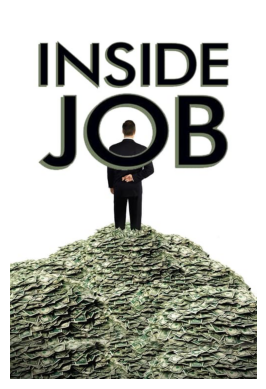

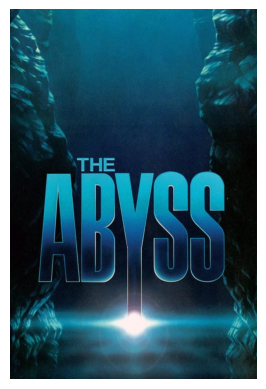

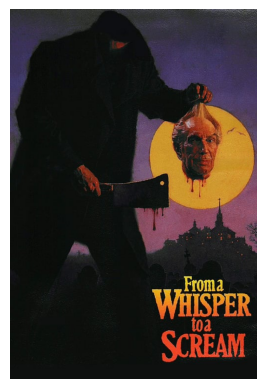

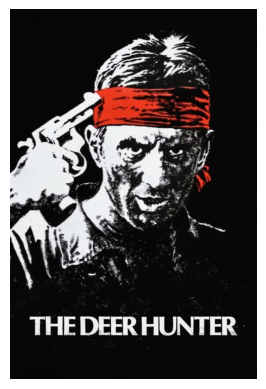

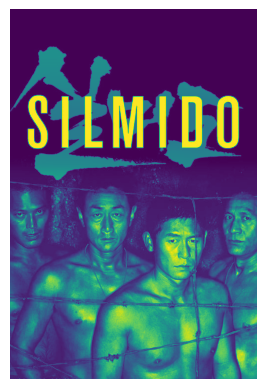

...

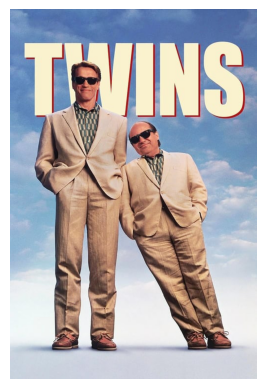

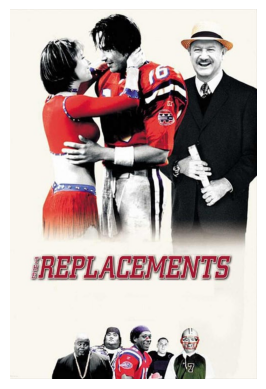

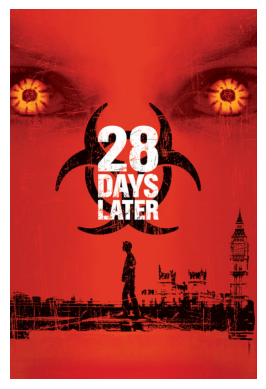

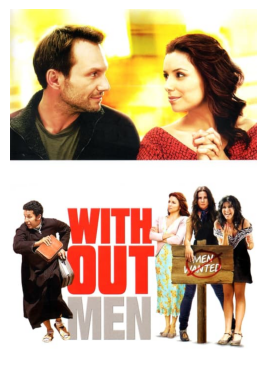

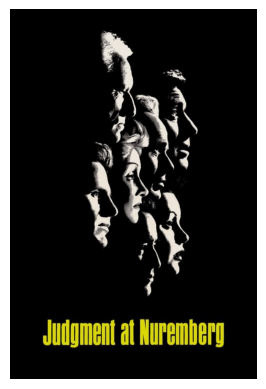

In [16]:
# Displaying posters

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

sample_df = df.sample(100)

for index, row in sample_df.iterrows():
    img = mpimg.imread(row["Poster Filename"])
    plt.imshow(img)
    plt.axis('off')
    plt.show()


In [17]:
# Data preparation: Resizing the posters so they have consistent size. The n converting to Tensor Images.
import torch
import torchvision.transforms as transforms
from PIL import Image

# Setting the desired image size
image_size = (224, 224)

def to_rgb(image):
    if image.mode == 'L':
        return image.convert('RGB')
    return image

# Defining the transformation
transform = transforms.Compose([
    transforms.Lambda(lambda x: to_rgb(x)),  # Convert grayscale images to RGB format
    transforms.Resize(image_size),
    transforms.ToTensor()
])

# Iterate over the movie posters and applying the transformation
preprocessed_images = []
for index, row in df.iterrows():
    img = Image.open(row["Poster Filename"])
    img = transform(img)
    preprocessed_images.append(img)

# Converting the preprocessed images to a tensor
tensor_images = torch.stack(preprocessed_images)


/Users/chirdeep/miniconda3/envs/tensorflow/lib/python3.10/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: 'dlopen(/Users/chirdeep/miniconda3/envs/tensorflow/lib/python3.10/site-packages/torchvision/image.so, 0x0006): Symbol not found: __ZN3c106detail19maybe_wrap_dim_slowIxEET_S2_S2_b
  Referenced from: <5AA8DD3D-A2CC-31CA-8060-88B4E9C18B09> /Users/chirdeep/miniconda3/envs/tensorflow/lib/python3.10/site-packages/torchvision/image.so
  Expected in:     <DA0809A3-4EF8-39B3-82E0-50F09210AA3E> /Users/chirdeep/miniconda3/envs/tensorflow/lib/python3.10/site-packages/torch/lib/libc10.dylib'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(


In [18]:
tensor_images

tensor([[[[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0

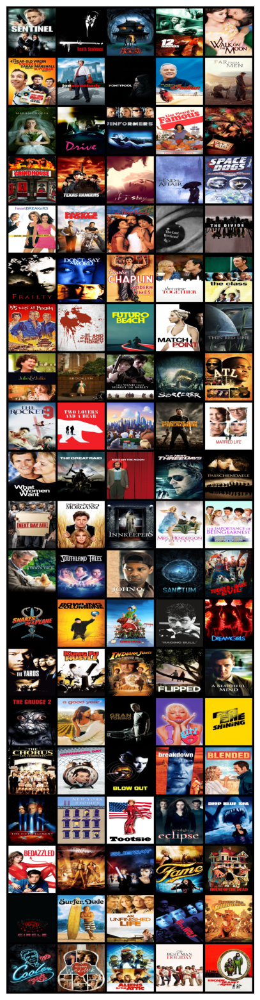

In [96]:
import matplotlib.pyplot as plt
import torchvision.utils as vutils

sample_tensor = tensor_images[torch.randperm(tensor_images.size(0))][:100]

# Converting the tensor images to a grid
grid_image = vutils.make_grid(sample_tensor, nrow=5, padding=10, normalize=True)

# Displaying the grid image 
plt.figure(figsize=(30,20))  
plt.imshow(grid_image.permute(1, 2, 0))
plt.axis('off')
plt.show()


In [20]:
import torch
import pandas as pd

# Directly convert tensor images to a list of byte strings
byte_images = [image.byte().numpy().tobytes() for image in tensor_images]

# Creating a new column in the DataFrame with the byte image data
df['Tensor Image'] = byte_images

df['ID'] = df['ID'].astype(int)

# Saving the DataFrame to a CSV file
df.to_csv("movie_info.csv", index=False)


In [22]:
df.head()

,ID,Title,Genres,Poster,Poster Filename,Tensor Image
0,19995,Avatar,"Action, Adventure, Fantasy, Science Fiction",/kyeqWdyUXW608qlYkRqosgbbJyK.jpg,19995.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...
1,285,Pirates of the Caribbean: At World's End,"Adventure, Fantasy, Action",/jGWpG4YhpQwVmjyHEGkxEkeRf0S.jpg,285.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...
2,206647,Spectre,"Action, Adventure, Thriller",/672kUEMtTHcaVYSVY4eiHEliHFa.jpg,206647.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...
3,49026,The Dark Knight Rises,"Action, Crime, Drama, Thriller",/hr0L2aueqlP2BYUblTTjmtn0hw4.jpg,49026.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...
4,49529,John Carter,"Action, Adventure, Science Fiction",/lCxz1Yus07QCQQCb6I0Dr3Lmqpx.jpg,49529.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...


In [24]:
# Building the Pre trained CNN Model ResNet50

from keras.applications.resnet50 import ResNet50, preprocess_input
from keras.preprocessing import image
from keras.models import Model
import numpy as np
import os

base_model = ResNet50(weights='imagenet')
model = Model(inputs=base_model.input, outputs=base_model.get_layer('avg_pool').output)

def extract_features(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    features = model.predict(x)
    return np.squeeze(features)




2023-08-11 13:36:15.611884: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M1 Pro
2023-08-11 13:36:15.611915: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 16.00 GB
2023-08-11 13:36:15.611922: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 5.33 GB
2023-08-11 13:36:15.612070: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:303] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-08-11 13:36:15.612322: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:269] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [27]:
#Using the ResNet Model for Feature Extraction on Movie Dataset

# Loading movie data
movies = pd.read_csv("movie_info.csv")

# Creating a new column in the dataframe to hold the features
movies["Features"] = ""

# Extracting features from each poster
for index, row in movies.iterrows():
    try:
        movie_id = row["ID"]
        filename = f"{movie_id}.jpg"
        features = extract_features(filename)
        movies.at[index, "Features"] = features
    except Exception as e:
        print(f"Error processing Movie ID {movie_id}: {e}")

# Saving the dataframe with features
movies.to_csv("movies_with_features.csv", index=False)

2023-08-11 13:36:53.475689: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 23ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 20ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


1/1 [==============================] - 0s 21ms/step


In [28]:
print(movies["Features"].head())

0    [2.046688, 0.22904088, 0.33696294, 0.47319886,...
1    [0.39983648, 0.07890721, 0.9021286, 0.51658124...
2    [0.84241974, 2.3246922, 0.43598774, 0.2270372,...
3    [1.2649708, 0.17000245, 0.73303854, 0.11080275...
4    [0.9722188, 1.6071519, 1.4320145, 1.2336116, 0...
Name: Features, dtype: object


In [30]:
print(movies["Features"].apply(lambda x: x.shape[0]).unique())

[2048]


In [31]:
movies

,ID,Title,Genres,Poster,Poster Filename,Tensor Image,Features
0,19995,Avatar,"Action, Adventure, Fantasy, Science Fiction",/kyeqWdyUXW608qlYkRqosgbbJyK.jpg,19995.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[2.046688, 0.22904088, 0.33696294, 0.47319886,..."
1,285,Pirates of the Caribbean: At World's End,"Adventure, Fantasy, Action",/jGWpG4YhpQwVmjyHEGkxEkeRf0S.jpg,285.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[0.39983648, 0.07890721, 0.9021286, 0.51658124..."
2,206647,Spectre,"Action, Adventure, Thriller",/672kUEMtTHcaVYSVY4eiHEliHFa.jpg,206647.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[0.84241974, 2.3246922, 0.43598774, 0.2270372,..."
3,49026,The Dark Knight Rises,"Action, Crime, Drama, Thriller",/hr0L2aueqlP2BYUblTTjmtn0hw4.jpg,49026.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[1.2649708, 0.17000245, 0.73303854, 0.11080275..."
4,49529,John Carter,"Action, Adventure, Science Fiction",/lCxz1Yus07QCQQCb6I0Dr3Lmqpx.jpg,49529.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[0.9722188, 1.6071519, 1.4320145, 1.2336116, 0..."
...,...,...,...,...,...,...,...
4763,9367,El Mariachi,"Action, Crime, Thriller",/zRh7K4SV1xQ419m8gzGITak51vc.jpg,9367.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[1.0860066, 1.4699554, 0.10882662, 0.1008549, ..."
4764,72766,Newlyweds,"Comedy, Romance, Drama",/zMEfv8533tJpNXwKbtd4ShcJQnC.jpg,72766.jpg,b'\x01\x01\x01\x01\x01\x01\x01\x01\x01\x01\x01...,"[0.054076154, 0.55191797, 0.0048229015, 1.3744..."
4765,231617,"Signed, Sealed, Delivered","Comedy, Drama, Romance, TV Movie",/6BVCgmhLeSTF8nPBuE9ncHHcCNv.jpg,231617.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[0.9066231, 1.1697754, 0.29926333, 0.03766125,..."
4766,126186,Shanghai Calling,"Romance, Comedy, Drama",/2a1q1RTxspKxGWbGKVpXFzl6MbV.jpg,126186.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[1.7287071, 0.26112765, 0.14336699, 1.1130315,..."


In [32]:
# Building the Autoencoder for Dimensionality Reduction

from keras.models import Sequential, Model
from keras.layers import Dense, Input
from keras.optimizers import Adam

# Dimension of encoded representations
encoding_dim = 128  # this is the size of our encoded representations

# Input shape for Auto encoder, we got 2048 from output of the 
input_img = Input(shape=(2048,))  # this is our input placeholder

# Encoder model
encoded = Dense(1024, activation='relu')(input_img)
encoded = Dense(encoding_dim, activation='relu')(encoded)

# Decoder model
decoded = Dense(1024, activation='relu')(encoded)
decoded = Dense(2048, activation='sigmoid')(decoded)

# Autoencoder model
autoencoder = Model(input_img, decoded)

# Separating encoder model for feature extraction
encoder = Model(input_img, encoded)

# Compiling the model
autoencoder.compile(optimizer=Adam(), loss='binary_crossentropy')

# Preparing the features for training the autoencoder
features = np.array([feat for feat in movies["Features"]])
features = features.astype('float32') / 255.

# Using the features to train the autoencoder
autoencoder.fit(features, features, epochs=30, batch_size=256, shuffle=True)


Epoch 1/30


2023-08-11 13:40:39.096784: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


19/19 [==============================] - 1s 15ms/step - loss: 0.4632
Epoch 2/30
19/19 [==============================] - 0s 13ms/step - loss: 0.0340
Epoch 3/30
19/19 [==============================] - 0s 11ms/step - loss: 0.0330
Epoch 4/30
19/19 [==============================] - 0s 11ms/step - loss: 0.0187
Epoch 5/30
19/19 [==============================] - 0s 11ms/step - loss: 0.0169
Epoch 6/30
19/19 [==============================] - 0s 11ms/step - loss: 0.0167
Epoch 7/30
19/19 [==============================] - 0s 11ms/step - loss: 0.0166
Epoch 8/30
19/19 [==============================] - 0s 11ms/step - loss: 0.0166
Epoch 9/30
19/19 [==============================] - 0s 11ms/step - loss: 0.0166
Epoch 10/30
19/19 [==============================] - 0s 11ms/step - loss: 0.0166
Epoch 11/30
19/19 [==============================] - 0s 11ms/step - loss: 0.0166
Epoch 12/30
19/19 [==============================] - 0s 11ms/step - loss: 0.0166
Epoch 13/30
19/19 [=============================

In [33]:
# Using the encoder to reduce dimensionality
reduced_features = encoder.predict(features)

# Adding the reduced features back to the dataframe
movies["Reduced_Features"] = list(reduced_features)

# Saving the dataframe with reduced features
movies.to_csv("movies_with_reduced_features.csv", index=False)


149/149 [==============================] - 0s 1ms/step


2023-08-11 13:40:45.794443: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


In [34]:
movies

,ID,Title,Genres,Poster,Poster Filename,Tensor Image,Features,Reduced_Features
0,19995,Avatar,"Action, Adventure, Fantasy, Science Fiction",/kyeqWdyUXW608qlYkRqosgbbJyK.jpg,19995.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[2.046688, 0.22904088, 0.33696294, 0.47319886,...","[0.54875386, 0.0, 0.0, 0.8202244, 0.48706365, ..."
1,285,Pirates of the Caribbean: At World's End,"Adventure, Fantasy, Action",/jGWpG4YhpQwVmjyHEGkxEkeRf0S.jpg,285.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[0.39983648, 0.07890721, 0.9021286, 0.51658124...","[0.53983444, 0.0, 0.0, 0.7882004, 0.47358146, ..."
2,206647,Spectre,"Action, Adventure, Thriller",/672kUEMtTHcaVYSVY4eiHEliHFa.jpg,206647.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[0.84241974, 2.3246922, 0.43598774, 0.2270372,...","[0.4995548, 0.0, 0.0, 0.7672255, 0.4496452, 0...."
3,49026,The Dark Knight Rises,"Action, Crime, Drama, Thriller",/hr0L2aueqlP2BYUblTTjmtn0hw4.jpg,49026.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[1.2649708, 0.17000245, 0.73303854, 0.11080275...","[0.5421454, 0.0, 0.0, 0.81323195, 0.4774139, 0..."
4,49529,John Carter,"Action, Adventure, Science Fiction",/lCxz1Yus07QCQQCb6I0Dr3Lmqpx.jpg,49529.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[0.9722188, 1.6071519, 1.4320145, 1.2336116, 0...","[0.51475847, 0.0, 0.0, 0.7739835, 0.45441326, ..."
...,...,...,...,...,...,...,...,...
4763,9367,El Mariachi,"Action, Crime, Thriller",/zRh7K4SV1xQ419m8gzGITak51vc.jpg,9367.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[1.0860066, 1.4699554, 0.10882662, 0.1008549, ...","[0.5663754, 0.0, 0.0, 0.83679634, 0.48464411, ..."
4764,72766,Newlyweds,"Comedy, Romance, Drama",/zMEfv8533tJpNXwKbtd4ShcJQnC.jpg,72766.jpg,b'\x01\x01\x01\x01\x01\x01\x01\x01\x01\x01\x01...,"[0.054076154, 0.55191797, 0.0048229015, 1.3744...","[0.48849767, 0.0, 0.0, 0.7637409, 0.44451812, ..."
4765,231617,"Signed, Sealed, Delivered","Comedy, Drama, Romance, TV Movie",/6BVCgmhLeSTF8nPBuE9ncHHcCNv.jpg,231617.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[0.9066231, 1.1697754, 0.29926333, 0.03766125,...","[0.5231256, 0.0, 0.0, 0.8032157, 0.46743843, 0..."
4766,126186,Shanghai Calling,"Romance, Comedy, Drama",/2a1q1RTxspKxGWbGKVpXFzl6MbV.jpg,126186.jpg,b'\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00...,"[1.7287071, 0.26112765, 0.14336699, 1.1130315,...","[0.4748542, 0.0, 0.0, 0.76222086, 0.44757763, ..."


In [35]:
#Using Cosine Similarity, Forming a Cosine Similarity Matrix.

from sklearn.metrics.pairwise import cosine_similarity

# Extracting the reduced features as a matrix
feature_matrix = np.array([feat for feat in movies["Reduced_Features"]])

# Computing the cosine similarity matrix
similarity_matrix = cosine_similarity(feature_matrix)

# Converting the similarity matrix to a DataFrame, for easy querying. 
similarity_df = pd.DataFrame(similarity_matrix, index=movies["Title"], columns=movies["Title"])


/Users/chirdeep/miniconda3/envs/tensorflow/lib/python3.10/site-packages/sklearn/utils/extmath.py:189: RuntimeWarning: invalid value encountered in matmul
  ret = a @ b


In [97]:
similarity_df

Title,Avatar,Pirates of the Caribbean: At World's End,Spectre,The Dark Knight Rises,John Carter,Spider-Man 3,Tangled,Avengers: Age of Ultron,Harry Potter and the Half-Blood Prince,Batman v Superman: Dawn of Justice,...,On The Downlow,Sanctuary; Quite a Conundrum,Bang,Primer,Cavite,El Mariachi,Newlyweds,"Signed, Sealed, Delivered",Shanghai Calling,My Date with Drew
Title,,,,,,,,,,,,,,,,,,,,,
Avatar,1.000000,0.999861,0.999740,0.999899,0.999950,0.999920,0.999931,0.999940,0.999820,0.999733,...,0.999630,0.999877,0.999226,0.999892,0.999868,0.999732,0.999221,0.999936,0.999086,0.999876
Pirates of the Caribbean: At World's End,0.999861,1.000000,0.999385,0.999928,0.999840,0.999898,0.999905,0.999834,0.999545,0.999921,...,0.999261,0.999934,0.998664,0.999850,0.999672,0.999894,0.998645,0.999783,0.998487,0.999951
Spectre,0.999740,0.999385,1.000000,0.999529,0.999753,0.999637,0.999621,0.999780,0.999955,0.999076,...,0.999936,0.999451,0.999807,0.999568,0.999905,0.999157,0.999811,0.999814,0.999718,0.999411
The Dark Knight Rises,0.999899,0.999928,0.999529,1.000000,0.999891,0.999929,0.999930,0.999873,0.999662,0.999850,...,0.999404,0.999938,0.998886,0.999902,0.999775,0.999858,0.998884,0.999862,0.998736,0.999941
John Carter,0.999950,0.999840,0.999753,0.999891,1.000000,0.999895,0.999928,0.999922,0.999838,0.999683,...,0.999665,0.999846,0.999258,0.999853,0.999892,0.999710,0.999263,0.999916,0.999143,0.999850
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
El Mariachi,0.999732,0.999894,0.999157,0.999858,0.999710,0.999809,0.999830,0.999647,0.999332,0.999930,...,0.998920,0.999892,0.998313,0.999830,0.999469,1.000000,0.998285,0.999704,0.998071,0.999938
Newlyweds,0.999221,0.998645,0.999811,0.998884,0.999263,0.999016,0.999002,0.999293,0.999701,0.998173,...,0.999856,0.998709,0.999965,0.998939,0.999577,0.998285,1.000000,0.999330,0.999952,0.998657
"Signed, Sealed, Delivered",0.999936,0.999783,0.999814,0.999862,0.999916,0.999893,0.999901,0.999910,0.999869,0.999636,...,0.999662,0.999836,0.999328,0.999875,0.999893,0.999704,0.999330,1.000000,0.999177,0.999833


In [62]:
print(similarity_df.shape)


(4768, 4768)


In [64]:
#Definig a Function for Querying a movie and fetching the top 5 nearest neighbours based on cosine similarity scores.

def get_similar_movies(movie_title, similarity_df, movies_df, n=5):
    
    """
    Get the n most similar movies to the given movie.

    :param movie_title: The title of the movie
    :param similarity_df: DataFrame containing the similarity of each pair of movies
    :param movies_df: DataFrame containing the original movies data
    :param n: The number of similar movies to return
    :return: A Series containing the n most similar movies to the given movie
    """
    
    if movie_title not in similarity_df.columns:
        return None, "Movie not found."
    
    # Get the similarity scores for the movie
    similarity_scores = similarity_df[movie_title]
    
    # Sort the movies based on the similarity scores
    most_similar_movies = similarity_scores.sort_values(ascending=False)
    
    # Exclude the first index since it's the same movie
    most_similar_movies = most_similar_movies.iloc[1:]

    # Get the top n similar movie names and their similarity scores
    similar_movies_names_scores = most_similar_movies.head(n)
    
    # Get the poster filenames of these movies from the original DataFrame
    similar_movies_posters = movies_df.loc[movies_df["Title"].isin(similar_movies_names_scores.index), "Poster Filename"]
    
    # Get the poster of the query movie
    query_movie_poster = movies_df.loc[movies_df["Title"] == movie_title, "Poster Filename"].values[0]

    # Display the query movie poster
    img = mpimg.imread(query_movie_poster)
    plt.figure(figsize=(20,10))
    plt.subplot(1, n+1, 1)
    plt.imshow(img)
    plt.title("Query Image")
    plt.axis('off')

    # Display the similar movie posters
    for i, (poster_filename, score) in enumerate(zip(similar_movies_posters, similar_movies_names_scores.values)):
        img = mpimg.imread(poster_filename)
        plt.subplot(1, n+1, i+2)
        plt.imshow(img)
        plt.title(f"Similar Image")
        plt.axis('off')

    plt.show()

    return list(similar_movies_names_scores.index)


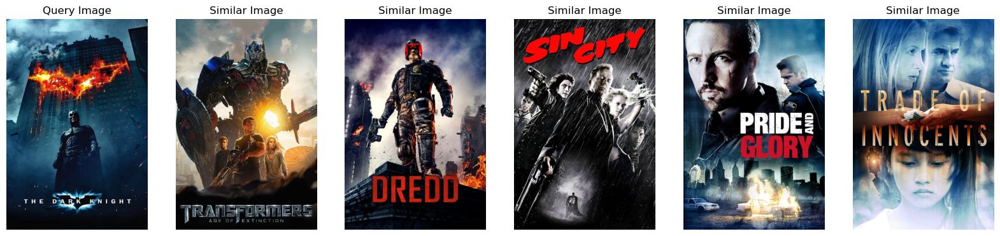

['Transformers: Age of Extinction',
 'Dredd',
 'Pride and Glory',
 'Trade of Innocents',
 'Sin City']

In [65]:
movie_title = "The Dark Knight"
get_similar_movies(movie_title, similarity_df, movies, 5)

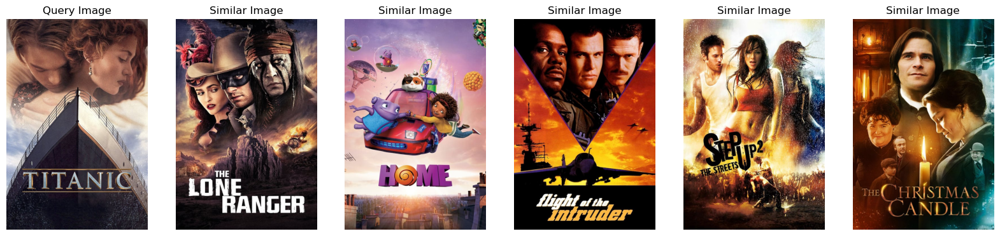

['Home',
 'Step Up 2: The Streets',
 'The Christmas Candle',
 'The Lone Ranger',
 'Flight of the Intruder']

In [66]:
movie_title = "Titanic"
get_similar_movies(movie_title, similarity_df, movies, 5)

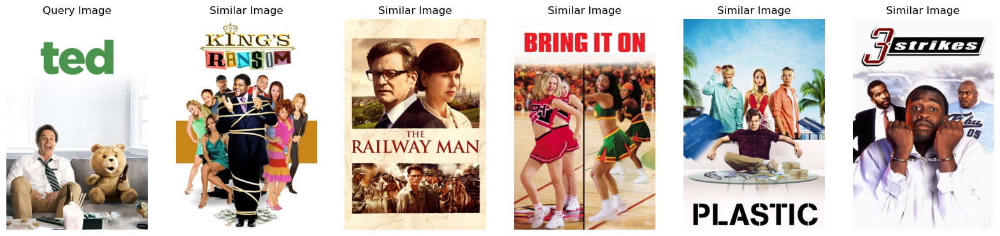

['Bring It On', "King's Ransom", 'Plastic', 'The Railway Man', '3 Strikes']

In [67]:
movie_title = "Ted"
get_similar_movies(movie_title, similarity_df, movies,5)

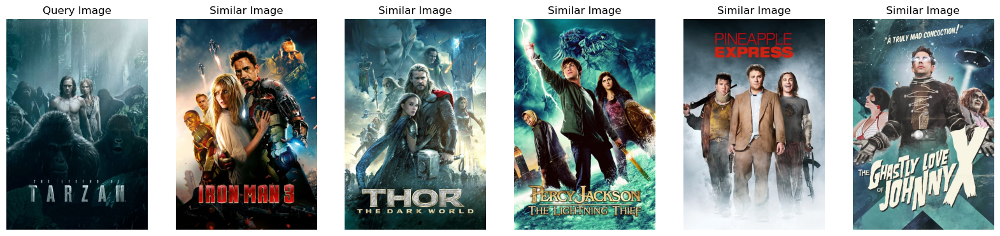

['Percy Jackson & the Olympians: The Lightning Thief',
 'Thor: The Dark World',
 'The Ghastly Love of Johnny X',
 'Iron Man 3',
 'Pineapple Express']

In [68]:
movie_title = "The Legend of Tarzan"
get_similar_movies(movie_title, similarity_df, movies, 5)

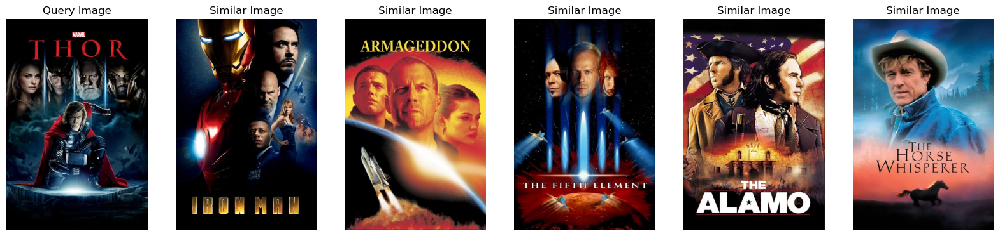

['The Horse Whisperer',
 'The Alamo',
 'Iron Man',
 'The Fifth Element',
 'Armageddon']

In [69]:
movie_title = "Thor"
get_similar_movies(movie_title, similarity_df, movies, 5)

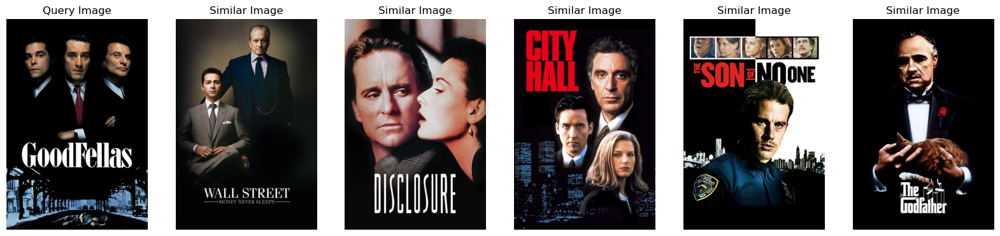

['City Hall',
 'The Son of No One',
 'The Godfather',
 'Disclosure',
 'Wall Street: Money Never Sleeps']

In [103]:
movie_title = "GoodFellas"
get_similar_movies(movie_title, similarity_df, movies, 5)

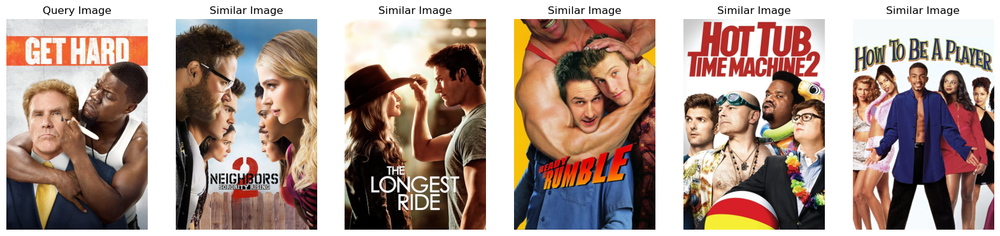

['Hot Tub Time Machine 2',
 'Ready to Rumble',
 'Neighbors 2: Sorority Rising',
 'How to Be a Player',
 'The Longest Ride']

In [104]:
movie_title = "Get Hard"
get_similar_movies(movie_title, similarity_df, movies, 5)

In [ ]:
#For the user to Input a movie from the dataset
movie_title = "" #Add movie title in quotations
get_similar_movies(movie_title, similarity_df, movies, 5)

In [94]:
import pandas as pd

# Defining a subset with similar and popular movie genres. 
movie_subset_ids = [6961,10563,9889,4967,11353,8355,9962,49963,44990,544,1921,10761,2752,41436,8810,1590,257091,21801,111794,77877,16538,268171,113947,810,2009,10521,23827,22897,334531,10758,40794,802,3981,22215,9842,144340,253235,10571,318846,49022,27995,57800,378200,4379,17127,1988,248774,38365,9689,4970,11478,14177,211954,279759,82687,2770,55180,13159,2105,6964,84178,862,16690,1901,49049,1542,4477,25643,45658,394047,72571,3078,2176,153795,193610,10744,11823,2830,42888,19265,39053,489,33909,44857,89857,81836,37056,44835,4944,10115,55,40185,38570,10229,35,1213,255266,509,63020,769]

# Fetching movie titles corresponding to the movie IDs
movie_subset_titles = movies[movies['ID'].isin(movie_subset_ids)]['Title'].tolist()

print(movie_subset_titles)

['Shrek the Third', 'How Do You Know', 'Ice Age: Continental Drift', 'Ice Age: Dawn of the Dinosaurs', "The Devil's Own", "It's Complicated", 'Dredd', "Something's Gotta Give", 'Grown Ups', 'The Simpsons Movie', 'Wall Street: Money Never Sleeps', 'What Women Want', 'Bowfinger', 'Lolita', 'Monster-in-Law', 'Notting Hill', 'Get Hard', 'The Talented Mr. Ripley', 'I Love You, Man', 'Shallow Hal', 'The Other Woman', 'Made of Honor', 'Gothika', 'The Guilt Trip', 'Sweet November', 'Burn After Reading', 'Something Borrowed', 'Wimbledon', 'American Pie 2', 'Toy Story', 'Bride Wars', 'Letters to Juliet', 'Keeping the Faith', 'The Big Short', 'In Good Company', 'The Lucky One', 'GoodFellas', 'Beauty Shop', 'Chéri', "There's Something About Mary", 'The Glass House', 'To Rome with Love', 'Molly', 'Return to Never Land', 'Stick It', 'Georgia Rule', 'School for Scoundrels', 'Three to Tango', 'My All American', 'Love Happens', 'And So It Goes', '40 Days and 40 Nights', 'Boys and Girls', 'Hollywood End

In [95]:
# For calculating the Average Jaccard Similarity Score for a Subset.

from statistics import mean 
def get_most_similar_movie(movie_title, similarity_df, movies_df, n=1):
    
    def jaccard_similarity(genre1, genre2):
        if isinstance(genre1, float) or isinstance(genre2, float): 
            return 0.0  # Handles NaN or other float values
        set1 = set(genre1.split(", "))
        set2 = set(genre2.split(", "))
        intersection_size = len(set1.intersection(set2))
        union_size = len(set1.union(set2))
        return 0.0 if union_size == 0 else intersection_size / union_size
    
    if movie_title not in similarity_df.columns:
        return 0.0
    
    # Get the similarity scores for the movie
    similarity_scores = similarity_df[movie_title]
    
    # Sort the movies based on the similarity scores
    most_similar_movies = similarity_scores.sort_values(ascending=False)
    
    # Exclude the first index since it's the same movie
    most_similar_movies = most_similar_movies.iloc[1:n+1]
    
    # Get genres of the query movie
    query_movie_genres = movies_df.loc[movies_df['Title'] == movie_title, 'Genres'].iloc[0]
    
    # Calculate Jaccard scores for the most similar movies
    jaccard_scores = []
    for similar_movie_title in most_similar_movies.index:
        similar_movie_genres = movies_df.loc[movies_df['Title'] == similar_movie_title, 'Genres'].iloc[0]
        score = jaccard_similarity(query_movie_genres, similar_movie_genres)
        jaccard_scores.append(score)

    # Compute the average Jaccard score
    average_jaccard = sum(jaccard_scores) / len(jaccard_scores) if jaccard_scores else 0.0

    return average_jaccard

average_jaccard_scores = []

for movie in movie_subset_titles:
    average_jaccard = get_most_similar_movie(movie, similarity_df, movies, n=3)  # Adjust n as needed
    average_jaccard_scores.append(average_jaccard)

mean_score = sum(average_jaccard_scores) / len(average_jaccard_scores)
print("Average Jaccard Similarity Score for subset:", mean_score)



Average Jaccard Similarity Score for subset: 0.7549999999999996


In [91]:
def get_most_similar_movie(movie_title, similarity_df, movies_df, n=1):
    
    # Compute Jaccard Similarity
    def jaccard_similarity(genre1, genre2):
        if not isinstance(genre1, str) or not isinstance(genre2, str):
            return 0.0  # or any other default value when genres are not available
        set1 = set(genre1.split(", "))
        set2 = set(genre2.split(", "))
        intersection_size = len(set1.intersection(set2))
        union_size = len(set1.union(set2))
        return 0.0 if union_size == 0 else intersection_size / union_size
    
    if movie_title not in similarity_df.columns:
        return None, "Movie not found.", None, None
    
    # Get the similarity scores for the movie
    similarity_scores = similarity_df[movie_title]
    
    # Sort the movies based on the similarity scores
    most_similar_movies = similarity_scores.sort_values(ascending=False)
    
    # Exclude the first index since it's the same movie
    most_similar_movies = most_similar_movies.iloc[1:n+1]

    # Assuming the index of most_similar_movies is the movie title
    similar_movie_title = most_similar_movies.index[0]
    
    # Get genres of the query movie and its most similar movie
    query_movie_genres = movies_df.loc[movies_df['Title'] == movie_title, 'Genres'].iloc[0]
    similar_movie_genres = movies_df.loc[movies_df['Title'] == similar_movie_title, 'Genres'].iloc[0]
    
    # Compute the Jaccard similarity between the genres
    genre_similarity = jaccard_similarity(query_movie_genres, similar_movie_genres)
    
    return most_similar_movies, query_movie_genres, similar_movie_genres, genre_similarity

In [92]:
all_movie_titles = movies['Title'].tolist()
total_similarity = 0
count = 0

for title in all_movie_titles:
    _, _, _, genre_sim = get_most_similar_movie(title, similarity_df, movies)
    if genre_sim is not None and genre_sim != 0.0:  # Exclude movies with missing genres and the default 0.0 similarity value
        total_similarity += genre_sim
        count += 1

average_similarity = total_similarity / count if count != 0 else 0

print(f"Average Jaccard similarity score for all movies: {average_similarity}")


Average Jaccard similarity score for all movies: 0.3825347506752893
